`Задание
Основные цели этого задания:`

Научиться строить архитектуру модели

Научиться распознавать факты переобучения и недообучения модели

Научить бороться с переобучением и недообучением модели путем варьирования ее гиперпараметров

Научиться применять методы регуляризации для контроля переобучения

`Задача:
`
`Построить модель нейронной сети, предсказывающую поломку программного обеспечения по его анонимным признакам. В данной задаче необходимо оптимизировать метрику ROC_AUC.`

Ссылка на датасет (https://disk.yandex.ru/d/Q05Dot1e1IqCCA)

`План решения:`

- Загрузите данные. `Проведите EDA` по вашему датасету, опишите основные идеи для последующей генерации новых признаков.

- Проведите `разбиение` на `тренировочные и валидационные данные`. Проведите необходимую `предобработку` данных для последующего обучения нейронной сети.

- `Реализуйте функцию`, в которой вы будете определять архитектуру модели. Функция должна возвращать скомпилированную модель.

- Обучите модель нейронной сети (без использования методов регуляризации) на исходной тренировочной выборке (без добавления новых признаков). В процессе обучения нужно отслеживать метрику ROC_AUC на каждой эпохе, на валидационных данных.

- Сгенерируйте новые признаки исходя из вашего EDA или наоборот — удалите ненужные признаки, которые препятствуют лучшему качеству модели при обучении. 

- Переобучите модель на данных, которые представляют из себя новый датафрейм, и оцените, как изменилось качество модели (то есть вы либо добавили новые признаки, либо удалили старые, либо всё вместе). Исходя из этого примите решение, какие новые признаки хорошо повлияли на качество, а какие нет.

- Собрав финальный датасет, который состоит из отфильтрованных (или добавленных) новых признаков, добавьте в вашу модель методы регуляризации — BatchNorm, Dropout, EarlyStopping, а также реализуйте автоматическое сохранение наилучших весов по метрике ROC_AUC на лучшей эпохе.

`Напишите вывод по всему проекту, он должен содержать в себе:`

- Какие методы регуляризации улучшили качество, а какие плохо повлияли

- Какие признаки повлияли на качество обучения (в лучшую сторону)

- Наилучшую метрику ROC_AUC на валидации

In [36]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.utils import class_weight

import seaborn as sns

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import phik as phik_matrix

from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dense, BatchNormalization, Dropout, GroupNormalization, LayerNormalization
from keras.callbacks import EarlyStopping, ModelCheckpoint

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go



import torch
import torch.nn as nn

- Загрузите данные. `Проведите EDA` по вашему датасету, опишите основные идеи для последующей генерации новых признаков.

In [2]:
df = pd.read_csv('train_3.2.csv')
df.head(15).T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
loc,22.0,14.0,11.0,8.0,11.0,23.0,24.0,14.0,34.0,9.0,16.0,8.0,19.0,83.0,6.0
v(g),3.0,2.0,2.0,1.0,2.0,4.0,4.0,1.0,10.0,2.0,2.0,1.0,1.0,11.0,1.0
ev(g),1.0,1.0,1.0,1.0,1.0,4.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
iv(g),2.0,2.0,2.0,1.0,2.0,3.0,4.0,1.0,4.0,2.0,2.0,1.0,1.0,4.0,1.0
n,60.0,32.0,45.0,23.0,17.0,69.0,60.0,49.0,122.0,16.0,51.0,15.0,54.0,141.0,17.0
v,278.63,151.27,197.65,94.01,60.94,338.21,294.41,221.65,684.98,55.35,236.84,51.89,240.81,879.58,58.81
l,0.06,0.14,0.11,0.19,0.18,0.07,0.08,0.18,0.07,0.11,0.11,0.19,0.13,0.06,0.19
d,19.56,7.0,8.05,5.25,5.63,14.15,12.46,5.47,14.33,9.0,9.5,5.25,7.72,17.86,5.25
i,14.25,21.11,22.76,17.86,12.44,22.81,24.62,46.06,43.43,6.15,23.01,9.88,28.23,49.25,11.2


In [3]:
df.describe(include='all').fillna('-').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
id,101763.0,-,-,-,50881.0,29376.592059,0.0,25440.5,50881.0,76321.5,101762.0
loc,101763.0,-,-,-,37.34716,54.600401,1.0,13.0,22.0,42.0,3442.0
v(g),101763.0,-,-,-,5.492684,7.900855,1.0,2.0,3.0,6.0,404.0
ev(g),101763.0,-,-,-,2.845022,4.631262,1.0,1.0,1.0,3.0,165.0
iv(g),101763.0,-,-,-,3.498826,5.534541,1.0,1.0,2.0,4.0,402.0
n,101763.0,-,-,-,96.655995,171.147191,0.0,25.0,51.0,111.0,8441.0
v,101763.0,-,-,-,538.280956,1270.791601,0.0,97.67,232.79,560.25,80843.08
l,101763.0,-,-,-,0.111634,0.100096,0.0,0.05,0.09,0.15,1.0
d,101763.0,-,-,-,13.681881,14.121306,0.0,5.6,9.82,18.0,418.2
i,101763.0,-,-,-,27.573007,22.856742,0.0,15.56,23.36,34.34,569.78


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101763 entries, 0 to 101762
Data columns (total 23 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   id                 101763 non-null  int64  
 1   loc                101763 non-null  float64
 2   v(g)               101763 non-null  float64
 3   ev(g)              101763 non-null  float64
 4   iv(g)              101763 non-null  float64
 5   n                  101763 non-null  float64
 6   v                  101763 non-null  float64
 7   l                  101763 non-null  float64
 8   d                  101763 non-null  float64
 9   i                  101763 non-null  float64
 10  e                  101763 non-null  float64
 11  b                  101763 non-null  float64
 12  t                  101763 non-null  float64
 13  lOCode             101763 non-null  int64  
 14  lOComment          101763 non-null  int64  
 15  lOBlank            101763 non-null  int64  
 16  lo

- изменим тип целевого таргета на числовой 

In [5]:
df['defects'] = df['defects'].replace({True: 1, False: 0})

In [6]:
print(f'Количество дубликатов в DataFrame = {df.duplicated().sum()}')

Количество дубликатов в DataFrame = 0


array([[<Axes: title={'center': 'id'}>, <Axes: title={'center': 'loc'}>,
        <Axes: title={'center': 'v(g)'}>,
        <Axes: title={'center': 'ev(g)'}>,
        <Axes: title={'center': 'iv(g)'}>],
       [<Axes: title={'center': 'n'}>, <Axes: title={'center': 'v'}>,
        <Axes: title={'center': 'l'}>, <Axes: title={'center': 'd'}>,
        <Axes: title={'center': 'i'}>],
       [<Axes: title={'center': 'e'}>, <Axes: title={'center': 'b'}>,
        <Axes: title={'center': 't'}>,
        <Axes: title={'center': 'lOCode'}>,
        <Axes: title={'center': 'lOComment'}>],
       [<Axes: title={'center': 'lOBlank'}>,
        <Axes: title={'center': 'locCodeAndComment'}>,
        <Axes: title={'center': 'uniq_Op'}>,
        <Axes: title={'center': 'uniq_Opnd'}>,
        <Axes: title={'center': 'total_Op'}>],
       [<Axes: title={'center': 'total_Opnd'}>,
        <Axes: title={'center': 'branchCount'}>,
        <Axes: title={'center': 'defects'}>, <Axes: >, <Axes: >]],
      dtype=ob

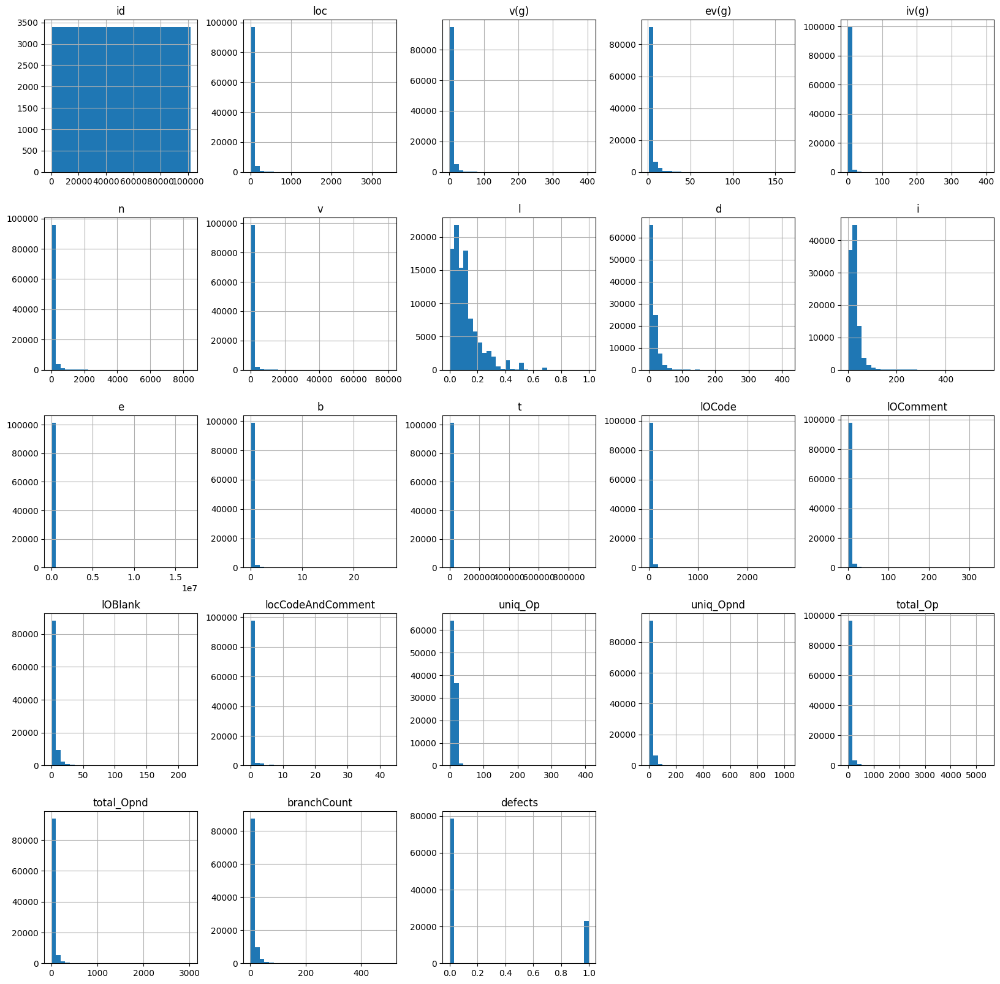

In [7]:
df.hist(figsize=(20,20), bins=30)

- у всех данных `не нормальное` распределение. Будем применять нормализацию.

In [8]:
cat_columns = []
num_columns = []
for column in df:
    if df[column].dtype == 'object':
        cat_columns.append(column)
    else:
        num_columns.append(column)

In [9]:
fig = make_subplots(rows=(len(df[num_columns].columns)+1), cols=1, vertical_spacing=0.014)

for i, col in enumerate(df[num_columns].columns):
    fig.append_trace(go.Box(x=df[col], name=col, orientation='h'), row=i+1, col=1)
    
fig.append_trace(go.Box(x=pd.to_datetime(df['defects'], dayfirst=True).sort_values(ascending=True), name='defects', orientation='h'), row=(len(df[num_columns].columns)+1), col=1)

fig.update_layout(height=2000, width=1110, showlegend=False)
fig.show()

c:\Users\Mi\AppData\Local\Programs\Python\Python311\Lib\site-packages\_plotly_utils\basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



- выглядит так, что в данных есть выбросы. Но так как мы не знаем природу данных, точно утверждать нельзя.

interval columns not set, guessing: ['id', 'loc', 'v(g)', 'ev(g)', 'iv(g)', 'n', 'v', 'l', 'd', 'i', 'e', 'b', 't', 'lOCode', 'lOComment', 'lOBlank', 'locCodeAndComment', 'uniq_Op', 'uniq_Opnd', 'total_Op', 'total_Opnd', 'branchCount', 'defects']


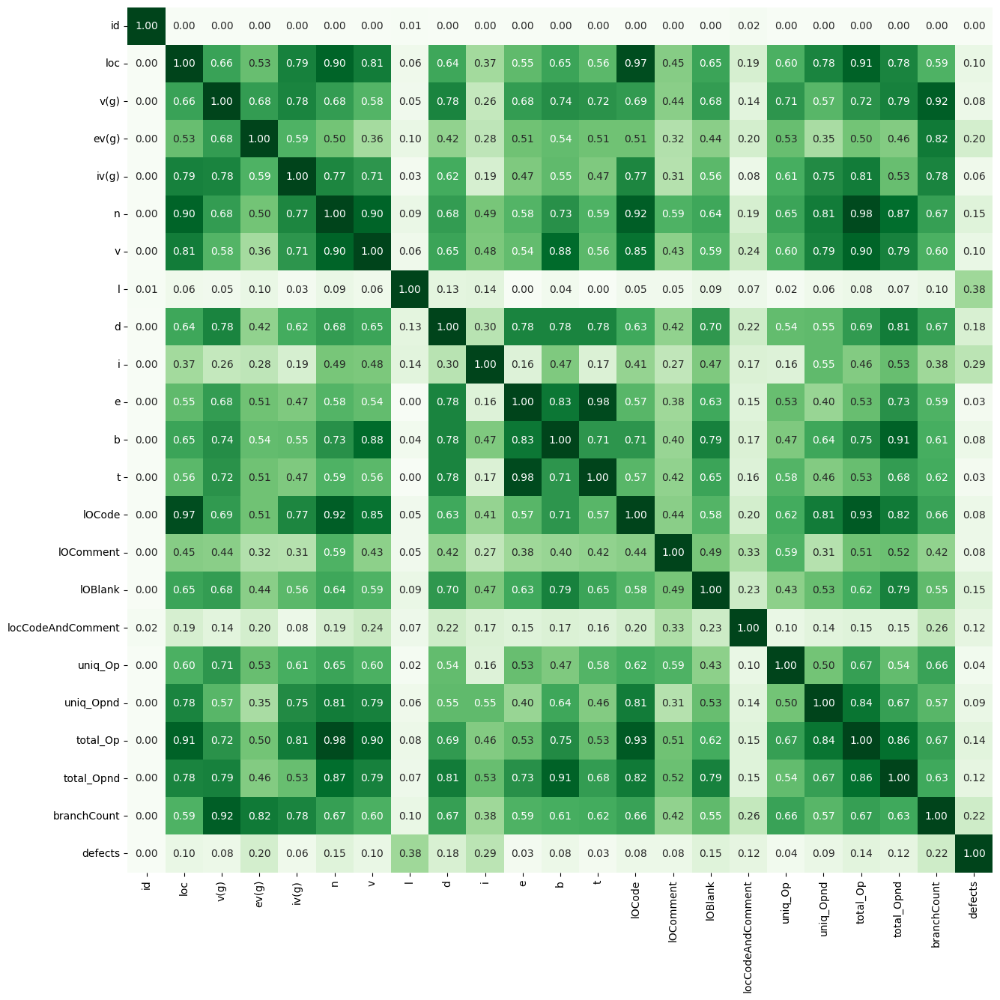

In [10]:
fig, ax = plt.subplots(figsize=(15, 15))

sns.heatmap(df.phik_matrix().round(2),
            cmap='Greens',
            square=True,
            vmin=0,
            annot=True,
            cbar=False,
            annot_kws={'fontsize': 10},
            fmt='.2f',
            ax=ax)

plt.xticks(rotation=90)

plt.show()

In [11]:
df.head(2).T

,0,1
id,0.00,1.00
loc,22.00,14.00
v(g),3.00,2.00
ev(g),1.00,1.00
iv(g),2.00,2.00
n,60.00,32.00
v,278.63,151.27
l,0.06,0.14
d,19.56,7.00
i,14.25,21.11


- фичи l, i, branchCount, ev(g), lOBlank, n - наиболее сильно коррелируют с целевым признаком defects

-------------------

- Проведите `разбиение` на `тренировочные и валидационные данные`. Проведите необходимую `предобработку` данных для последующего обучения нейронной сети.

X - Фичи
y - таргет

In [12]:
X = df.drop('defects',axis=1)
y = df.defects

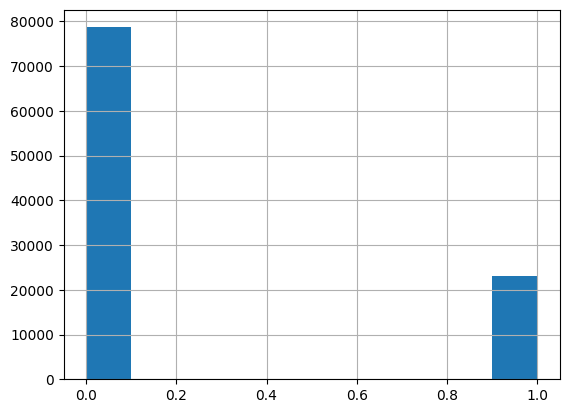

In [13]:
y.hist();

- разбиваем наши выборки. Применяем stratify - работает только в мульти-классовых задачах и задачах классификации.

In [14]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

- нормализуем наши данные

In [15]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_val = scaler.transform(X_val)

---------------------

- `Реализуйте функцию`, в которой вы будете определять архитектуру модели. Функция должна возвращать скомпилированную модель.

- Модель под бинарную классификацию

In [16]:
n = X_train.shape[1]

def nw():
    model = Sequential()
    model.add(Dense(128, activation='relu', input_dim=n))
    model.add(Dense(64, activation='relu'))
    model.add(Dense(32, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(optimizer='adam',
                  loss='binary_crossentropy',
                  metrics=['AUC']
                  )
    
    return model

- Получение весов классов. Так как у нас дисбаланс классов. видно из гистограмм 

<Axes: >

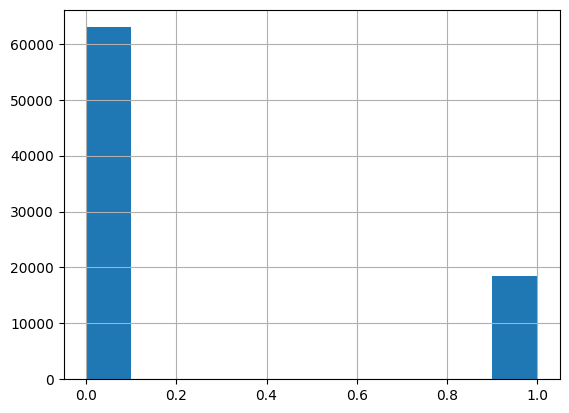

In [17]:
y_train.hist()

In [18]:
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
class_weights

array([0.64653187, 2.20611349])

- в итоге веса: 0 класс - 0.64653187    1 класс - 2.20611349

--------------------------------

- Обучите модель нейронной сети (без использования методов регуляризации) на исходной тренировочной выборке (без добавления новых признаков). В процессе обучения нужно отслеживать метрику ROC_AUC на каждой эпохе, на валидационных данных.

In [19]:
model = nw()

history = model.fit(X_train, y_train,
           validation_data=(X_val, y_val),
           epochs=25,
           batch_size=128,
           class_weight={0:class_weights[0], 1:class_weights[1]})

Epoch 1/25
637/637 [==============================] - 2s 2ms/step - loss: 0.5632 - auc: 0.7821 - val_loss: 0.5546 - val_auc: 0.7893
Epoch 2/25
637/637 [==============================] - 1s 2ms/step - loss: 0.5561 - auc: 0.7876 - val_loss: 0.5752 - val_auc: 0.7896
Epoch 3/25
637/637 [==============================] - 1s 2ms/step - loss: 0.5546 - auc: 0.7885 - val_loss: 0.5518 - val_auc: 0.7920
Epoch 4/25
637/637 [==============================] - 1s 2ms/step - loss: 0.5539 - auc: 0.7892 - val_loss: 0.5221 - val_auc: 0.7906
Epoch 5/25
637/637 [==============================] - 1s 1ms/step - loss: 0.5536 - auc: 0.7894 - val_loss: 0.5616 - val_auc: 0.7906
Epoch 6/25
637/637 [==============================] - 1s 1ms/step - loss: 0.5532 - auc: 0.7897 - val_loss: 0.5620 - val_auc: 0.7903
Epoch 7/25
637/637 [==============================] - 1s 1ms/step - loss: 0.5528 - auc: 0.7902 - val_loss: 0.5646 - val_auc: 0.7899
Epoch 8/25
637/637 [==============================] - 1s 1ms/step - loss: 0.

In [20]:
def check_metrics(history, figure_name):

    train = history.history[f'{figure_name}']
    val = history.history[f'val_{figure_name}']

    # Построение графика лосса и валидационного лосса
    epochs = range(1, len(train) + 1)
    plt.plot(epochs, train, 'b', label=f'Training {figure_name}', color='orange')
    plt.plot(epochs, val, 'b', label=f'Validation {figure_name}')
    plt.title(f'Training and Validation {figure_name}')
    plt.xlabel('Epochs')
    plt.ylabel(f'{figure_name}')
    plt.legend()
    plt.show()

C:\Users\Mi\AppData\Local\Temp\ipykernel_24580\2180351603.py:8: UserWarning:

color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.



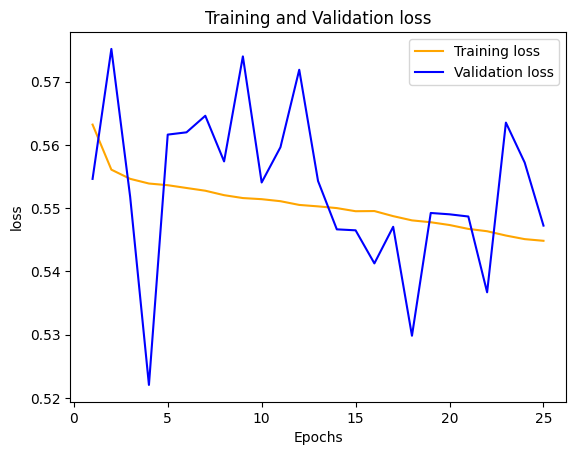

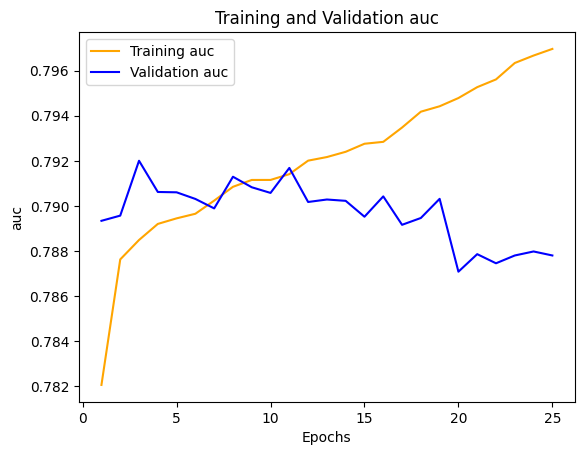

In [21]:
check_metrics(history, 'loss')
check_metrics(history, 'auc')

- `Максимальное значение по метрике val_auc на валидационной выборке: 0.7919      Epoch 4/15  `

`Выводы`:  модель явно не оптимальна + явная проблема с фичами (их нехватка). Видно, как модель переобучается (расхождение графиков)

-----------------------

- Сгенерируйте новые признаки (`nf`) исходя из вашего EDA или наоборот — удалите ненужные признаки, которые препятствуют лучшему качеству модели при обучении. 

In [22]:
X.shape

(101763, 22)

- Удалим фичи которые наиболее слабо коррелируют с целевым признаком

In [23]:
X = X.drop(columns=['id', 't', 'e', 'uniq_Opnd','v(g)'])


- добавим квадраты фичей наиболее сильно коррелирующих признаков

In [24]:
X['l_sqr'] = X['l']**2
X['i_sqr'] = X['i']**2
X['branchCount_sqr'] = X['branchCount']**2
X['ev(g)_sqr'] = X['ev(g)']**2
X['n_sqr'] = X['n']**2
X['lOBlank_sqr'] = X['lOBlank']**2

- создадим цикл для генерации новых фичей

In [25]:
new_features_df = pd.DataFrame()

for feature1 in X.columns:
    for feature2 in X.columns:
        if feature1 == feature2:
            continue
        new_feature = X[feature1] * X[feature2]
        new_features_df[f"{feature1}_mult_{feature2}"] = new_feature

X_wnf = pd.concat([X, new_features_df], axis=1)

C:\Users\Mi\AppData\Local\Temp\ipykernel_24580\4042493250.py:8: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\Mi\AppData\Local\Temp\ipykernel_24580\4042493250.py:8: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\Mi\AppData\Local\Temp\ipykernel_24580\4042493250.py:8: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

In [26]:
X_wnf.shape

(101763, 529)

In [27]:
X_train_nf, X_val_nf, y_train_nf, y_val_nf = train_test_split(X_wnf, y, test_size=0.2, random_state=42, stratify=y)

In [28]:
scaler_nf = StandardScaler()
X_train_nf = scaler_nf.fit_transform(X_train_nf)
X_val_nf = scaler_nf.transform(X_val_nf)

-----------------------------------

- Переобучите модель на данных, которые представляют из себя новый датафрейм, и оцените, как изменилось качество модели (то есть вы либо добавили новые признаки, либо удалили старые, либо всё вместе). Исходя из этого примите решение, какие новые признаки хорошо повлияли на качество, а какие нет.

In [29]:
n = X_train_nf.shape[1]

model = nw()

history = model.fit(X_train_nf, y_train_nf,
           validation_data=(X_val_nf, y_val_nf),
           epochs=25,
           batch_size=128,
           class_weight={0:class_weights[0], 1:class_weights[1]})

Epoch 1/25
637/637 [==============================] - 2s 2ms/step - loss: 0.5729 - auc: 0.7797 - val_loss: 0.5370 - val_auc: 0.7870
Epoch 2/25
637/637 [==============================] - 1s 2ms/step - loss: 0.5598 - auc: 0.7860 - val_loss: 0.5552 - val_auc: 0.7898
Epoch 3/25
637/637 [==============================] - 1s 2ms/step - loss: 0.5591 - auc: 0.7871 - val_loss: 0.5467 - val_auc: 0.7888
Epoch 4/25
637/637 [==============================] - 1s 2ms/step - loss: 0.5581 - auc: 0.7873 - val_loss: 0.5162 - val_auc: 0.7891
Epoch 5/25
637/637 [==============================] - 1s 2ms/step - loss: 0.5565 - auc: 0.7886 - val_loss: 0.5611 - val_auc: 0.7892
Epoch 6/25
637/637 [==============================] - 1s 2ms/step - loss: 0.5556 - auc: 0.7892 - val_loss: 0.5634 - val_auc: 0.7902
Epoch 7/25
637/637 [==============================] - 1s 2ms/step - loss: 0.5541 - auc: 0.7895 - val_loss: 0.5568 - val_auc: 0.7908
Epoch 8/25
637/637 [==============================] - 1s 2ms/step - loss: 0.

C:\Users\Mi\AppData\Local\Temp\ipykernel_24580\2180351603.py:8: UserWarning:

color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.



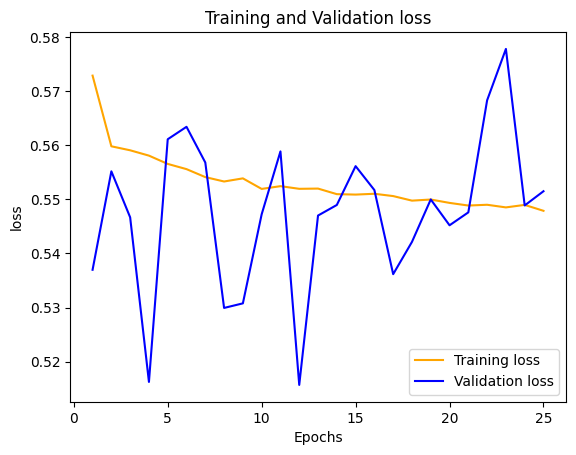

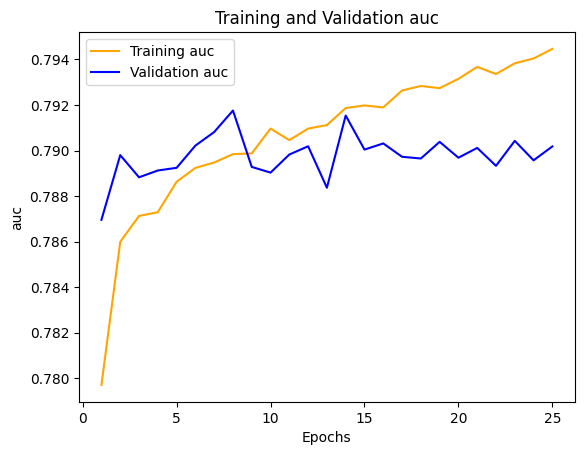

In [30]:
check_metrics(history, 'loss')
check_metrics(history, 'auc')

- `Максимальное значение по метрике val_auc на валидационной выборке: 0.7916      Epoch 17/15  `

Вывод: генерация новых признаков повлияла положительно, хоть и не на много.. 

--------------------------------------------

- Собрав финальный датасет, который состоит из отфильтрованных (или добавленных) новых признаков, добавьте в вашу модель методы регуляризации — BatchNorm, Dropout, EarlyStopping, а также реализуйте автоматическое сохранение наилучших весов по метрике ROC_AUC на лучшей эпохе.

In [42]:
def nw_2():
    model = Sequential()
    model.add(Dense(128, activation='relu', input_dim=n))
    model.add(Dense(64, activation='relu'))
    model.add(Dropout(0.15))
    model.add(Dense(50, activation='relu'))
    model.add(Dropout(0.05))
    model.add(Dense(40, activation='relu'))
    model.add(Dropout(0.03))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.05))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(optimizer='adam',
                  loss='binary_crossentropy',
                  metrics=['AUC']
                  )
    
    return model

In [43]:
model = nw_2()

early_stopping = EarlyStopping(monitor='val_auc', patience=5)
save_best_weights = ModelCheckpoint(filepath='.',
                                    save_weights_only=True,
                                    monitor='val_auc',
                                    mode='max',
                                    save_best_only=True)
history = model.fit(X_train_nf, y_train_nf,
                    validation_data=(X_val_nf, y_val_nf),
                    epochs=25,
                    batch_size=200,
                    class_weight={0:class_weights[0], 1:class_weights[1]},
                    callbacks=[early_stopping, save_best_weights])

Epoch 1/25
408/408 [==============================] - 4s 6ms/step - loss: 0.5744 - auc: 0.7740 - val_loss: 0.5537 - val_auc: 0.7852
Epoch 2/25
408/408 [==============================] - 2s 5ms/step - loss: 0.5657 - auc: 0.7818 - val_loss: 0.5823 - val_auc: 0.7866
Epoch 3/25
408/408 [==============================] - 2s 5ms/step - loss: 0.5628 - auc: 0.7834 - val_loss: 0.5522 - val_auc: 0.7895
Epoch 4/25
408/408 [==============================] - 2s 5ms/step - loss: 0.5594 - auc: 0.7856 - val_loss: 0.5532 - val_auc: 0.7907
Epoch 5/25
408/408 [==============================] - 2s 5ms/step - loss: 0.5592 - auc: 0.7855 - val_loss: 0.5531 - val_auc: 0.7864
Epoch 6/25
408/408 [==============================] - 2s 5ms/step - loss: 0.5594 - auc: 0.7863 - val_loss: 0.5553 - val_auc: 0.7905
Epoch 7/25
408/408 [==============================] - 2s 4ms/step - loss: 0.5581 - auc: 0.7870 - val_loss: 0.5793 - val_auc: 0.7883
Epoch 8/25
408/408 [==============================] - 2s 5ms/step - loss: 0.

C:\Users\Mi\AppData\Local\Temp\ipykernel_24580\2180351603.py:8: UserWarning:

color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.



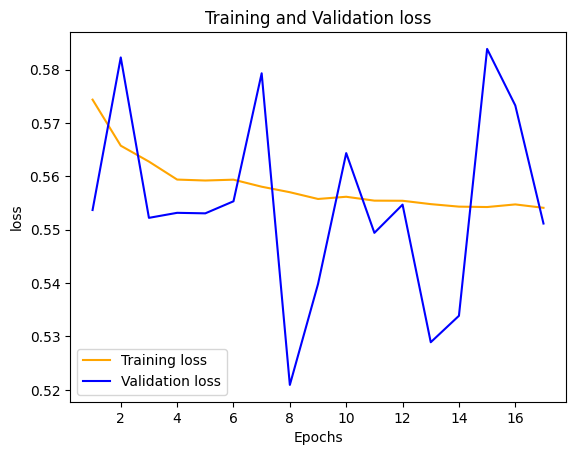

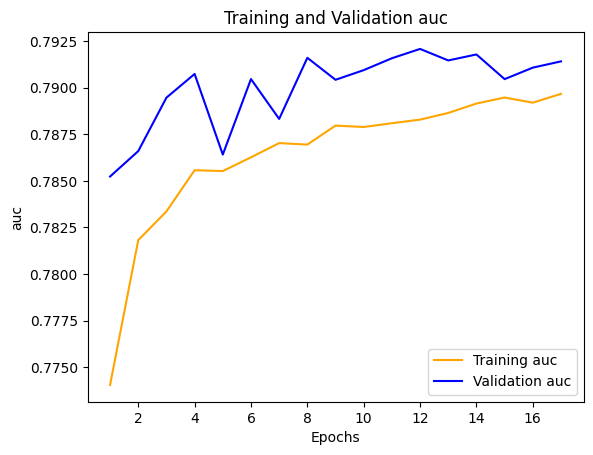

In [44]:
check_metrics(history, 'loss')
check_metrics(history, 'auc')

`Вывод:`

1. При увеличении значения `Dropout` при регуляризации - удается получить более сглаженные графики + модель не уходит в переобучение !
   - регуляризация `BatchNormalization` - к сожалению не всегда улучшает качество модели!!!

2. batch_size - существенно влияет на качество и скорость работы модели

3. в лучшую сторону на качество обучения повлияли признаки которые имеют наибольшую корреляцию с целевым признаком (построение матрицы корреляции)

4. `Наилучшую` метрику `ROC_AUC` которую удалось показать на валидации -  `0.7920`

5. `И самое главное !` Попытки сгенерить новые фичи - существенного прироста не дало 

Функций активации (основные):

1. Сигмоидная функция активации ( `sigmoid` ):
   - Формула:  `f(x) = 1 / (1 + exp(-x))` 
   - Диапазон значений: [0, 1]
   - Часто используется в задачах бинарной классификации

2. Гиперболический тангенс ( `tanh` ):
   - Формула:  `f(x) = (exp(x) - exp(-x)) / (exp(x) + exp(-x))` 
   - Диапазон значений: [-1, 1]
   - Полезен в задачах, где требуется центрирование данных

3. Линейная функция активации ( `linear` ):
   - Формула:  `f(x) = x` 
   - Просто передает входные значения без изменений
   - Используется в задачах регрессии или в случаях, когда не требуется нелинейное преобразование

4. Гиперболический тангенс сжатый ( `tanh` ):
   - Формула:  `f(x) = 1.7159 * tanh(2/3 * x)` 
   - Диапазон значений: [-1, 1]
   - Полезен в задачах, где требуется центрирование данных

5. Функция активации softmax ( `softmax` ):
   - Формула:  `f(x_i) = exp(x_i) / sum(exp(x_j))`  для каждого элемента x_i в векторе x
   - Применяется в задачах многоклассовой классификации, где требуется получить вероятности для каждого класса


Методы нормализации (основные):

1. Нормализация по мини-пакетам ( `BatchNormalization` ): Этот метод нормализует значения признаков в каждом мини-пакете данных путем вычисления среднего и стандартного отклонения. Он помогает ускорить обучение и повысить устойчивость модели.

2. Нормализация по экземплярам ( `InstanceNormalization` ): Этот метод нормализует значения признаков для каждого экземпляра данных посредством вычисления среднего и стандартного отклонения только для данного экземпляра. Он обычно используется в задачах обработки изображений.

3. Нормализация по слоям ( `LayerNormalization` ): Этот метод нормализует значения признаков в каждом слое путем вычисления среднего и стандартного отклонения только для данного слоя. Он широко применяется в рекуррентных нейронных сетях (RNN) и трансформерах.

4. Нормализация по группам ( `GroupNormalization` ): Этот метод нормализует значения признаков, разделяя их на несколько групп и вычисляя среднее и стандартное отклонение внутри каждой группы. Он полезен, когда размер пакета данных мал или когда данные имеют специфическую структуру.